In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.optimizers import RMSprop, Adam
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras.callbacks import CSVLogger
from livelossplot import PlotLossesKeras


Using TensorFlow backend.


In [10]:
TRAINING_LOGS_FILE = "jewelry_type_cnn_training_logs.csv"
MODEL_SUMMARY_FILE = "jewelry_type_cnn_model_summary.txt"
TEST_FILE = "test_file.txt"
MODEL_FILE = "jewelry_type_cnn_model.h5"

In [4]:
# Hyperparameters
img_size = 100
img_width, img_height = img_size, img_size
n_epochs = 10
batch_size = 32
test_size = 30 ##CHECK THIS
channels = 3 # color
class_mode = 'binary'

input_shape = (img_width, img_height, channels)

# READING IMAGES

In [12]:
def read_images(dir):
    # rescales images
    datagen = ImageDataGenerator(rescale=1./255)
    
    generator = datagen.flow_from_directory(
        dir,
        target_size = (img_width, img_height),
        batch_size = batch_size,
        color_mode = 'rgb',
        class_mode = class_mode
    )
    
    return(generator)

In [13]:
datasets = {
    'train': 'data/training', 
    'test': 'data/testing', 
    'valid': 'data/validation',}

key_to_generator = {k: read_images(v) for k,v in datasets.items()}

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


In [14]:
key_to_generator

{'train': <keras.preprocessing.image.DirectoryIterator at 0x6333b6940>,
 'test': <keras.preprocessing.image.DirectoryIterator at 0x6333b68d0>,
 'valid': <keras.preprocessing.image.DirectoryIterator at 0x6333b6cc0>}

In [8]:
key_to_generator['train']

# MODEL 1

In [8]:
model_1 = Sequential()

model_1.add(Conv2D(32,(3,3), input_shape = input_shape))
model_1.add(Activation('relu'))
model_1.add(MaxPooling2D(pool_size=(2,2)))

model_1.add(Conv2D(32,(3,3), input_shape = input_shape))
model_1.add(Activation('relu'))
model_1.add(MaxPooling2D(pool_size=(2,2)))

model_1.add(Flatten())
model_1.add(Dense(16))
model_1.add(Activation('relu'))
model_1.add(Dropout(0.5))
model_1.add(Dense(1))
model_1.add(Activation('sigmoid'))

model_1.compile(loss = 'binary_crossentropy',
               optimizer='rmsprop',
               metrics=['accuracy'])

In [9]:
model_1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 198, 198, 32)      896       
_________________________________________________________________
activation_1 (Activation)    (None, 198, 198, 32)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 99, 99, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 97, 97, 32)        9248      
_________________________________________________________________
activation_2 (Activation)    (None, 97, 97, 32)        0         
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 48, 48, 32)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 73728)            

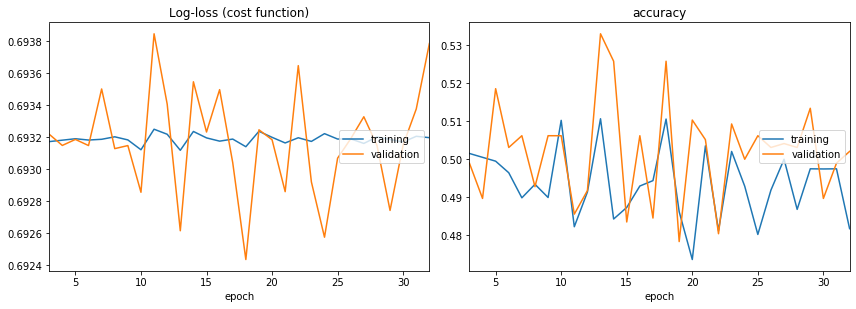

Log-loss (cost function):
training   (min:    0.693, max:    0.803, cur:    0.693)
validation (min:    0.692, max:    0.694, cur:    0.694)

accuracy:
training   (min:    0.474, max:    0.511, cur:    0.482)
validation (min:    0.478, max:    0.533, cur:    0.502)


In [10]:
model_1.fit_generator(
    key_to_generator['train'],
    steps_per_epoch=len(key_to_generator['train'].filenames) // batch_size,
    epochs=n_epochs,
    validation_data=key_to_generator['valid'],
    validation_steps=len(key_to_generator['valid'].filenames) // batch_size,
    callbacks=[PlotLossesKeras(), CSVLogger(TRAINING_LOGS_FILE,
                                            append=False,
                                            separator=";")], 
    verbose=1)

Accuracy is wavers around 0.5, so it pretty much guessing.Log loss is all over the place.

# MODEL 2

In [11]:
model_2 = Sequential()

model_2.add(Conv2D(32, (3, 3), input_shape=input_shape))
model_2.add(Activation('relu'))
model_2.add(MaxPooling2D(pool_size=(2, 2)))

model_2.add(Conv2D(64, (3, 3)))
model_2.add(Activation('relu'))
model_2.add(MaxPooling2D(pool_size=(2, 2)))

model_2.add(Conv2D(128, (3, 3)))
model_2.add(Activation('relu'))
model_2.add(MaxPooling2D(pool_size=(2, 2)))

model_2.add(Flatten())
model_2.add(Dense(128))
model_2.add(Activation('relu'))
model_2.add(Dropout(0.5))
model_2.add(Dense(1))
model_2.add(Activation('sigmoid'))

model_2.compile(loss='binary_crossentropy',
		optimizer='rmsprop',
		metrics=['accuracy'])

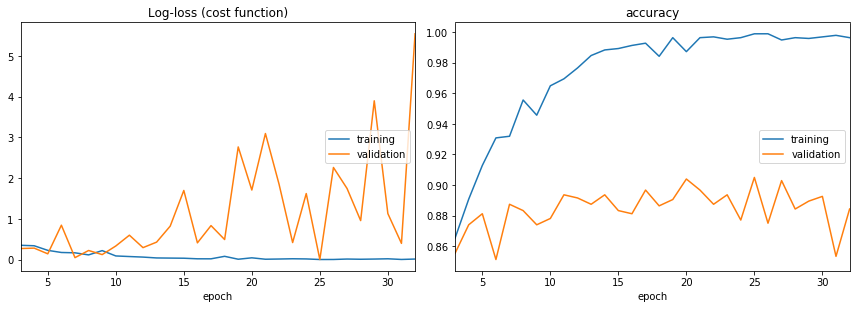

Log-loss (cost function):
training   (min:    0.004, max:    0.731, cur:    0.016)
validation (min:    0.004, max:    5.545, cur:    5.545)

accuracy:
training   (min:    0.720, max:    0.999, cur:    0.996)
validation (min:    0.841, max:    0.905, cur:    0.884)


In [12]:
model_2.fit_generator(
    key_to_generator['train'],
    steps_per_epoch=len(key_to_generator['train'].filenames) // batch_size,
    epochs=n_epochs,
    validation_data=key_to_generator['valid'],
    validation_steps=len(key_to_generator['valid'].filenames) // batch_size,
    callbacks=[PlotLossesKeras(), CSVLogger(TRAINING_LOGS_FILE,
                                            append=False,
                                            separator=";")], 
    verbose=1)

We can see that the validation loss is way below the training loss and the training accuracy is way below the validation accuracy. It means that our model is overfitting.Def improved in accuracy tho.

# MODEL 3

In [15]:
model_3 = Sequential()

model_3.add(Conv2D(32, (3, 3), padding='same', input_shape=input_shape, activation='relu'))
model_3.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model_3.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model_3.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model_3.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Flatten())
model_3.add(Dense(256, activation='relu'))
model_3.add(Dropout(0.5))

model_3.add(Dense(256, activation='relu'))
model_3.add(Dropout(0.5))

model_3.add(Dense(1))
model_3.add(Activation('sigmoid'))
    
model_3.compile(loss='binary_crossentropy',
            optimizer=RMSprop(lr=0.0001),
            metrics=['accuracy'])

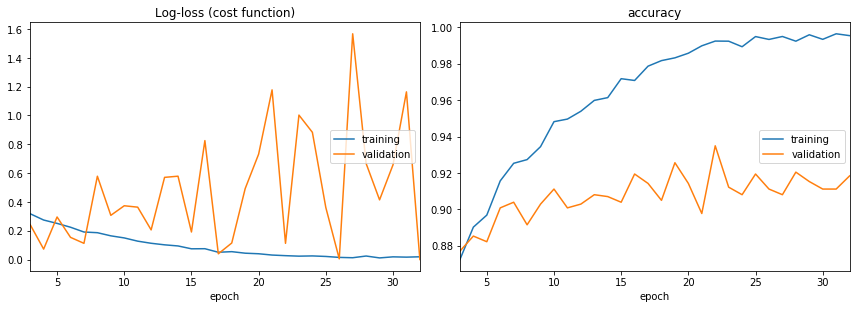

Log-loss (cost function):
training   (min:    0.011, max:    0.617, cur:    0.019)
validation (min:    0.000, max:    1.567, cur:    0.000)

accuracy:
training   (min:    0.643, max:    0.996, cur:    0.995)
validation (min:    0.730, max:    0.935, cur:    0.918)


In [16]:
model_3.fit_generator(
    key_to_generator['train'],
    steps_per_epoch=len(key_to_generator['train'].filenames) // batch_size,
    epochs=n_epochs,
    validation_data=key_to_generator['valid'],
    validation_steps=len(key_to_generator['valid'].filenames) // batch_size,
    callbacks=[PlotLossesKeras(), CSVLogger(TRAINING_LOGS_FILE,
                                            append=False,
                                            separator=";")], 
    verbose=1)

In [17]:
model_3.save_weights(MODEL_FILE)

In [30]:
predictions = model_3.predict(key_to_generator['test'])

In [ ]:
predictions

In [35]:
key_to_generator['test'].classes[2]

0

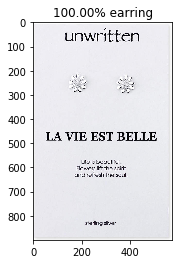

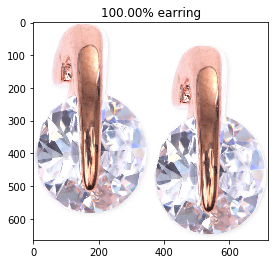

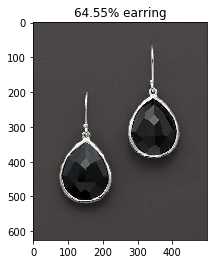

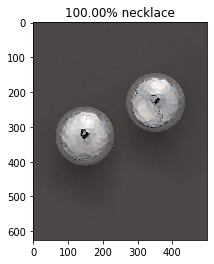

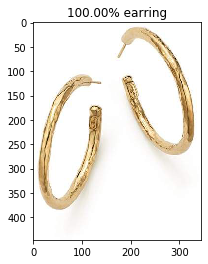

...

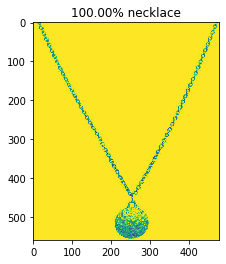

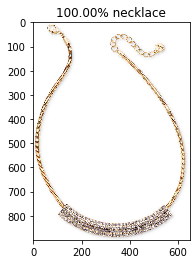

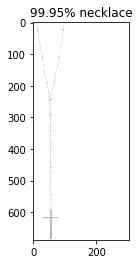

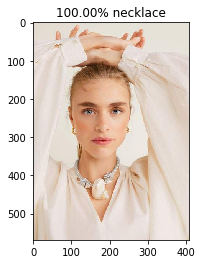

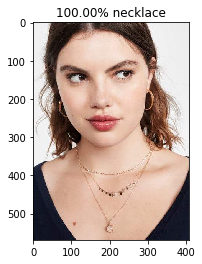

In [24]:
# Testing
open(TEST_FILE,"w")
probabilities = model_3.predict_generator(key_to_generator['test'], test_size)
for index, probability in enumerate(probabilities):
    image_path = datasets['test'] + "/" +key_to_generator['test'].filenames[index]
    img = mpimg.imread(image_path)
    with open(TEST_FILE,"a") as fh:
        fh.write(str(probability[0]) + " for: " + image_path + "\n")
    plt.imshow(img)
    if probability > 0.5:
        plt.title("%.2f" % (probability[0]*100) + "% necklace")
    else:
        plt.title("%.2f" % ((1-probability[0])*100) + "% earring")
    plt.show()

In [27]:
key_to_generator['test']

In [ ]:
keras.metrics.binary_accuracy(y_true, y_pred, threshold=0.5)

# MODEL 4

In [7]:
model_4 = Sequential()

model_4.add(Conv2D(32, (3, 3), input_shape=input_shape))
model_4.add(Activation('relu'))
model_4.add(MaxPooling2D(pool_size=(2, 2)))

model_4.add(Conv2D(64, (3, 3)))
model_4.add(Activation('relu'))
model_4.add(MaxPooling2D(pool_size=(2, 2)))

model_4.add(Conv2D(128, (3, 3)))
model_4.add(Activation('relu'))
model_4.add(MaxPooling2D(pool_size=(2, 2)))

model_4.add(Flatten())
model_4.add(Dense(128))
model_4.add(Activation('relu'))
model_4.add(Dropout(0.5))
model_4.add(Dense(1))
model_4.add(Activation('sigmoid'))

model_4.compile(loss='binary_crossentropy',
		optimizer='adam',
		metrics=['accuracy'])

In [ ]:
model_4.fit_generator(
    key_to_generator['train'],
    steps_per_epoch=len(key_to_generator['train'].filenames) // batch_size,
    epochs=n_epochs,
    validation_data=key_to_generator['valid'],
    validation_steps=len(key_to_generator['valid'].filenames) // batch_size,
    callbacks=[PlotLossesKeras(), CSVLogger(TRAINING_LOGS_FILE,
                                            append=False,
                                            separator=";")], 
    verbose=1)

In [8]:
model_4.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 98, 98, 32)        896       
_________________________________________________________________
activation_1 (Activation)    (None, 98, 98, 32)        0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 49, 49, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 47, 47, 64)        18496     
_________________________________________________________________
activation_2 (Activation)    (None, 47, 47, 64)        0         
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 23, 23, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 21, 21, 128)      

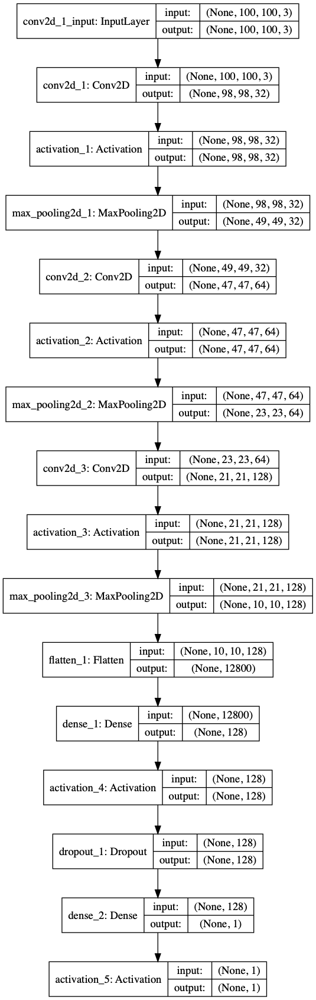

In [10]:
from keras.utils import plot_model
plot_model(model_4, 'jewelry_cnn_classifier_final.png', show_shapes=True)